# Janatahack Healthcare Analytics - II

In [3]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import plotly.express as px
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, plot_confusion_matrix
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from lightgbm import LGBMClassifier, LGBMRegressor
from sklearn import preprocessing
import optuna
from optuna.samplers import TPESampler

In [48]:
#train = pd.read_csv('/kaggle/input/av-healthcare-analytics-ii/healthcare/train_data.csv')
#test = pd.read_csv('/kaggle/input/av-healthcare-analytics-ii/healthcare/test_data.csv')
#sub = pd.read_csv('/kaggle/input/av-healthcare-analytics-ii/healthcare/sample_submission.csv')
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
sub=pd.read_csv('sample_submission.csv')
train = train.drop(['case_id'], axis=1)
test = test.drop(['case_id'], axis=1)
train['dataset'] = 'train'
test['dataset'] = 'test'
df = pd.concat([train, test])

In [5]:
df

,Hospital_code,Hospital_type_code,City_Code_Hospital,Hospital_region_code,Available Extra Rooms in Hospital,Department,Ward_Type,Ward_Facility_Code,Bed Grade,patientid,City_Code_Patient,Type of Admission,Severity of Illness,Visitors with Patient,Age,Admission_Deposit,Stay,dataset
0,8,c,3,Z,3,radiotherapy,R,F,2.0,31397,7.0,Emergency,Extreme,2,51-60,4911.0,0-10,train
1,2,c,5,Z,2,radiotherapy,S,F,2.0,31397,7.0,Trauma,Extreme,2,51-60,5954.0,41-50,train
2,10,e,1,X,2,anesthesia,S,E,2.0,31397,7.0,Trauma,Extreme,2,51-60,4745.0,31-40,train
3,26,b,2,Y,2,radiotherapy,R,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,7272.0,41-50,train
4,26,b,2,Y,2,radiotherapy,S,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,5558.0,41-50,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
137052,11,b,2,Y,4,anesthesia,Q,D,3.0,41160,3.0,Emergency,Minor,4,41-50,6313.0,NaN,test
137053,25,e,1,X,2,radiotherapy,R,E,4.0,30985,7.0,Emergency,Moderate,2,0-10,3510.0,NaN,test
137054,30,c,3,Z,2,anesthesia,R,A,4.0,81811,12.0,Urgent,Minor,2,0-10,7190.0,NaN,test
137055,5,a,1,X,2,anesthesia,R,E,4.0,57021,10.0,Trauma,Minor,2,41-50,5435.0,NaN,test


In [6]:
ds = df.groupby(['Hospital_code', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['hospital', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='hospital', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Cases per hospital distribution', 
    width=900,
    height=700
)
fig.show()

In [7]:
ds = df.groupby(['Hospital_type_code', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['hospital', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='hospital', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Cases hospital type distribution', 
    width=900,
    height=600
)
fig.show()

In [8]:
ds = df.groupby(['Hospital_region_code', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['hospital', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='hospital', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Cases hospital region distribution', 
    width=900,
    height=600
)
fig.show()

In [9]:
ds = df.groupby(['Department', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['department', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='department', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Department distribution', 
    width=900,
    height=600
)
fig.show()

In [10]:
ds = df.groupby(['Ward_Type', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['Ward_Type', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='Ward_Type', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Ward Type distribution', 
    width=900,
    height=600
)
fig.show()

In [11]:
ds = ds[ds['dataset']=='train']
fig = px.pie(
    ds, 
    names='Ward_Type', 
    values="count", 
    title='Ward type pie chart for train set', 
    width=900,
    height=600
)
fig.show()

In [12]:
ds = df.groupby(['Ward_Facility_Code', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['Ward_Facility_Code', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='Ward_Facility_Code', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Ward Facility Code distribution', 
    width=900,
    height=600
)
fig.show()

In [13]:
ds = df.groupby(['Bed Grade', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['bed_grade', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='bed_grade', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Bed_grade distribution', 
    width=900,
    height=600
)
fig.show()

In [14]:
ds = df.groupby(['Age', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['age', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='age', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Age distribution', 
    width=900,
    height=600
)
fig.show()

In [15]:

ds = df.groupby(['Type of Admission', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['admission', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='admission', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Admission type distribution', 
    width=900,
    height=600
)
fig.show()

In [16]:
ds = df.groupby(['Severity of Illness', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['Severity of Illness', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='Severity of Illness', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Severity of Illness type distribution', 
    width=900,
    height=600
)
fig.show()

In [17]:
ds = df.groupby(['Stay', 'dataset'])['patientid'].count().reset_index()
ds.columns = ['Stay', 'dataset', 'count']
fig = px.bar(
    ds, 
    x='Stay', 
    y="count", 
    color = 'dataset',
    barmode='group',
    orientation='v', 
    title='Stay length distribution', 
    width=900,
    height=600
)
fig.show()

In [18]:
data = df['patientid'].value_counts().reset_index()
data.columns = ['patientid', 'cases']
data['patientid'] = 'patient ' + data['patientid'].astype(str)
data = data.sort_values('cases')
fig = px.bar(
    data.tail(50), 
    x="cases", 
    y="patientid", 
    orientation='h', 
    title='Top 50 patients',
    width=800,
    height=900
)
fig.show()

In [19]:
fig = px.histogram(
    df, 
    "City_Code_Patient", 
    nbins=40, 
    color = 'dataset',
    barmode='group',
    title='City_Code_Patient', 
    width=700,
    height=600
)
fig.show()

In [20]:
fig = px.histogram(
    df, 
    "Visitors with Patient", 
    nbins=40, 
    color = 'dataset',
    barmode='group',
    title='Visitors with Patient', 
    width=700,
    height=600
)
fig.show()

In [21]:
fig = px.histogram(
    df, 
    "Admission_Deposit", 
    nbins=50, 
    color = 'dataset',
    barmode='group',
    title='Admission Deposit destribution', 
    width=700,
    height=600
)
fig.show()

### Time to start preparing dataset for modeling

In [22]:
df.loc[df['Stay'] == '0-10', 'Stay'] = 0
df.loc[df['Stay'] == '11-20', 'Stay'] = 1
df.loc[df['Stay'] == '21-30', 'Stay'] = 2
df.loc[df['Stay'] == '31-40', 'Stay'] = 3
df.loc[df['Stay'] == '41-50', 'Stay'] = 4
df.loc[df['Stay'] == '51-60', 'Stay'] = 5
df.loc[df['Stay'] == '61-70', 'Stay'] = 6
df.loc[df['Stay'] == '71-80', 'Stay'] = 7
df.loc[df['Stay'] == '81-90', 'Stay'] = 8
df.loc[df['Stay'] == '91-100', 'Stay'] = 9
df.loc[df['Stay'] == 'More than 100 Days', 'Stay'] = 10

### Lets try first linear model only on numerical features

In [23]:
train = df[df['dataset']=='train']
test = df[df['dataset']=='test']

target = train['Stay']

features = ['Available Extra Rooms in Hospital', 'Bed Grade', 'Visitors with Patient', 'Admission_Deposit']

train = train[features]
train = train.fillna(0)
test = test[features]

In [24]:
X, X_val, y, y_val = train_test_split(train, target, random_state=0, test_size=0.2, shuffle=True)
y=y.astype('int')
y_val=y_val.astype('int')

In [25]:
model = LogisticRegression(random_state=666)
model.fit(X, y)
preds = model.predict(X_val)
print('Baseline accuracy: ', accuracy_score(y_val, preds)*100, '%')

/home/abishek/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Baseline accuracy:  35.02386634844869 %


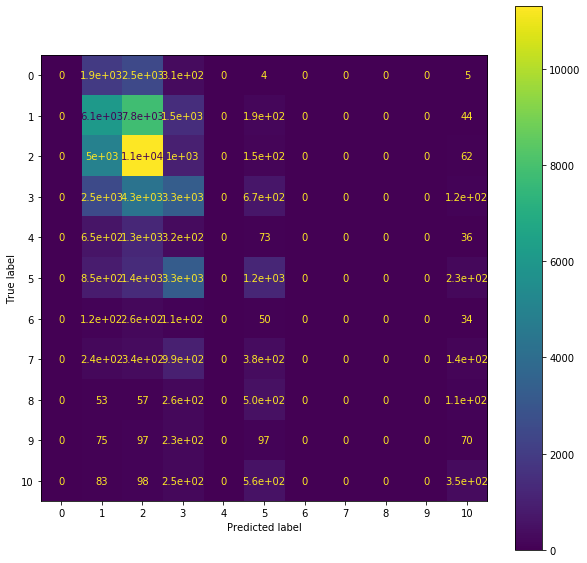

In [26]:
fig, ax = plt.subplots(figsize=(10, 10))
plot_confusion_matrix(model, X_val, y_val, ax=ax)

### Let's build LightGBM classifier

In [27]:
need_to_encode = ['Hospital_type_code', 'Hospital_region_code', 'Department', 'Ward_Type', 'Ward_Facility_Code', 'Type of Admission', 'Severity of Illness']
for column in need_to_encode:
    le = preprocessing.LabelEncoder()
    le.fit(df[column])
    df[column] = le.transform(df[column])

In [28]:
df.loc[df['Age'] == '0-10', 'Age'] = 0
df.loc[df['Age'] == '11-20', 'Age'] = 1
df.loc[df['Age'] == '21-30', 'Age'] = 2
df.loc[df['Age'] == '31-40', 'Age'] = 3
df.loc[df['Age'] == '41-50', 'Age'] = 4
df.loc[df['Age'] == '51-60', 'Age'] = 5
df.loc[df['Age'] == '61-70', 'Age'] = 6
df.loc[df['Age'] == '71-80', 'Age'] = 7
df.loc[df['Age'] == '81-90', 'Age'] = 8
df.loc[df['Age'] == '91-100', 'Age'] = 9

In [29]:
categorical = ['Hospital_code', 'Hospital_type_code', 'City_Code_Hospital', 'Hospital_region_code', 'Department', 'Ward_Type', 'Ward_Facility_Code', 
              'City_Code_Patient', 'Type of Admission', 'Severity of Illness']

In [30]:
train = df[df['dataset']=='train']
test = df[df['dataset']=='test']

target = train['Stay']
train = train.fillna(0)
test = test.fillna(0)
train = train.drop(['patientid', 'dataset', 'Stay'], axis=1)
test = test.drop(['patientid', 'dataset'], axis=1)
train

,Hospital_code,Hospital_type_code,City_Code_Hospital,Hospital_region_code,Available Extra Rooms in Hospital,Department,Ward_Type,Ward_Facility_Code,Bed Grade,City_Code_Patient,Type of Admission,Severity of Illness,Visitors with Patient,Age,Admission_Deposit
0,8,2,3,2,3,3,2,5,2.0,7.0,0,0,2,5,4911.0
1,2,2,5,2,2,3,3,5,2.0,7.0,1,0,2,5,5954.0
2,10,4,1,0,2,1,3,4,2.0,7.0,1,0,2,5,4745.0
3,26,1,2,1,2,3,2,3,2.0,7.0,1,0,2,5,7272.0
4,26,1,2,1,2,3,3,3,2.0,7.0,1,0,2,5,5558.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318433,6,0,6,0,3,3,1,5,4.0,23.0,0,2,3,4,4144.0
318434,24,0,1,0,2,1,1,4,4.0,8.0,2,2,4,8,6699.0
318435,7,0,4,0,3,2,2,5,4.0,10.0,0,1,3,7,4235.0
318436,11,1,2,1,3,1,1,3,3.0,8.0,1,1,5,1,3761.0


In [31]:
X, X_val, y, y_val = train_test_split(train, target, random_state=0, test_size=0.2, shuffle=True)
y=y.astype('int')
y_val=y_val.astype('int')

In [36]:
model = LGBMClassifier(random_state=666)
model.fit(X, y, categorical_feature=categorical)
preds = model.predict(X_val)
print('LGBM accuracy: ', accuracy_score(y_val, preds)*100, '%')

LGBM accuracy:  42.77885943976887 %


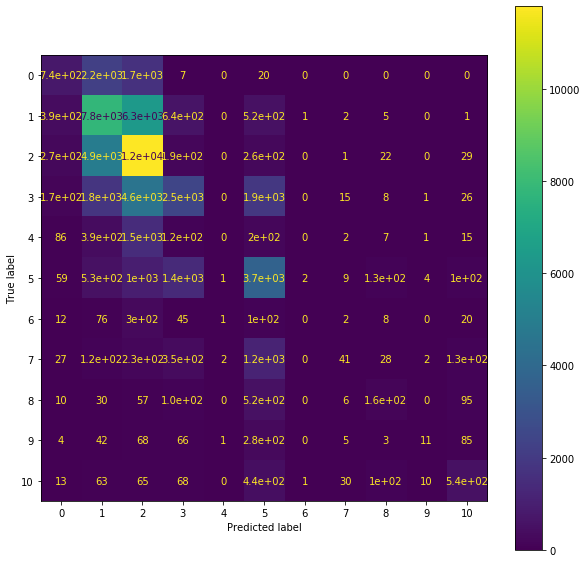

In [37]:
fig, ax = plt.subplots(figsize=(10, 10))
plot_confusion_matrix(model, X_val, y_val, ax=ax)

### We can see that we improved our score without any serious preprocessing of data and hyperparameters tunning. Let's do it next.

### Optuna optimization

In [38]:
sampler = TPESampler(seed=0)
def create_model(trial):
    max_depth = trial.suggest_int("max_depth", 2, 30)
    n_estimators = trial.suggest_int("n_estimators", 1, 500)
    learning_rate = trial.suggest_uniform('learning_rate', 0.0000001, 1)
    num_leaves = trial.suggest_int("num_leaves", 2, 5000)
    min_child_samples = trial.suggest_int('min_child_samples', 3, 200)
    model = LGBMClassifier(learning_rate=learning_rate, n_estimators=n_estimators, max_depth=max_depth, num_leaves=num_leaves, min_child_samples=min_child_samples,
                           random_state=0)
    return model

def objective(trial):
    model = create_model(trial)
    model.fit(X, y)
    preds = model.predict(X_val)
    return accuracy_score(y_val, preds)

def optimize():
    study = optuna.create_study(direction="maximize", sampler=sampler)
    study.optimize(objective, n_trials=20)
    return study.best_params

params = optimize()

[I 2020-09-04 17:54:41,636] Trial 0 finished with value: 0.3723778419796508 and parameters: {'max_depth': 14, 'n_estimators': 48, 'learning_rate': 0.7151893948534829, 'num_leaves': 4933, 'min_child_samples': 198}. Best is trial 0 with value: 0.3723778419796508.
[I 2020-09-04 17:54:46,784] Trial 1 finished with value: 0.4200634342419294 and parameters: {'max_depth': 9, 'n_estimators': 10, 'learning_rate': 0.6235637344296027, 'num_leaves': 3470, 'min_child_samples': 61}. Best is trial 1 with value: 0.4200634342419294.
[I 2020-09-04 17:55:33,500] Trial 2 finished with value: 0.1394611229745007 and parameters: {'max_depth': 3, 'n_estimators': 487, 'learning_rate': 0.8121687475586203, 'num_leaves': 2224, 'min_child_samples': 91}. Best is trial 1 with value: 0.4200634342419294.
[I 2020-09-04 17:57:13,959] Trial 3 finished with value: 0.17915462881547545 and parameters: {'max_depth': 19, 'n_estimators': 166, 'learning_rate': 0.8360787799295012, 'num_leaves': 2165, 'min_child_samples': 200}. B

In [39]:
params['random_state'] = 666
model = LGBMClassifier(**params)
model.fit(X, y, categorical_feature=categorical)
preds = model.predict(X_val)
print('LGBM accuracy: ', accuracy_score(y_val, preds)*100, '%')

LGBM accuracy:  43.10074111292551 %


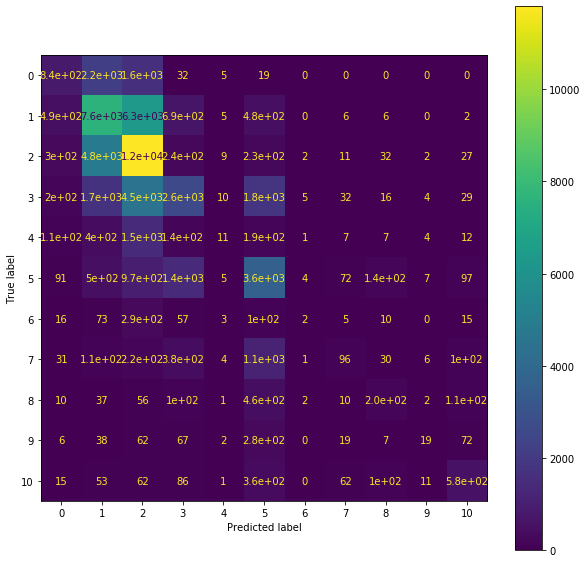

In [40]:
fig, ax = plt.subplots(figsize=(10, 10))
plot_confusion_matrix(model, X_val, y_val, ax=ax)

### Submission

In [42]:
X.columns

Index(['Hospital_code', 'Hospital_type_code', 'City_Code_Hospital',
       'Hospital_region_code', 'Available Extra Rooms in Hospital',
       'Department', 'Ward_Type', 'Ward_Facility_Code', 'Bed Grade',
       'City_Code_Patient', 'Type of Admission', 'Severity of Illness',
       'Visitors with Patient', 'Age', 'Admission_Deposit'],
      dtype='object')

In [43]:
test.columns

Index(['Hospital_code', 'Hospital_type_code', 'City_Code_Hospital',
       'Hospital_region_code', 'Available Extra Rooms in Hospital',
       'Department', 'Ward_Type', 'Ward_Facility_Code', 'Bed Grade',
       'City_Code_Patient', 'Type of Admission', 'Severity of Illness',
       'Visitors with Patient', 'Age', 'Admission_Deposit', 'Stay'],
      dtype='object')

In [44]:
preds = model.predict(test.drop('Stay',axis=1))

In [49]:
sub['Stay']=preds

In [51]:
sub.loc[sub['Stay'] == 0, 'Stay'] = '0-10'
sub.loc[sub['Stay'] == 1, 'Stay'] = '11-20'
sub.loc[sub['Stay'] == 2, 'Stay'] = '21-30'
sub.loc[sub['Stay'] == 3, 'Stay'] = '31-40'
sub.loc[sub['Stay'] == 4, 'Stay'] = '41-50'
sub.loc[sub['Stay'] == 5, 'Stay'] = '51-60'
sub.loc[sub['Stay'] == 6, 'Stay'] = '61-70'
sub.loc[sub['Stay'] == 7, 'Stay'] = '71-80'
sub.loc[sub['Stay'] == 8, 'Stay'] = '81-90'
sub.loc[sub['Stay'] == 9, 'Stay'] = '91-100'
sub.loc[sub['Stay'] == 10, 'Stay'] = 'More than 100 Days'

In [53]:
sub.to_csv('lgbm.csv',index=False)